# <font color=green>deepBreaks Applications</font>
## Modeling spectral tuning sites of opsin proteins based on amino-acid sequence...  

# <font color=red>Step 0: mySQL DB Setup -</font> Script 0
## *The following text is a script written in mySQL format. You can copy and paste this directly into a mySQL text file or query window within mySQL workbench.*
```
DROP DATABASE vizphiz;
CREATE DATABASE vizphiz;
USE vizphiz;

CREATE TABLE lamdamax
(
id int unsigned not null primary key,
genus varchar(50),
species varchar(50),
celltype varchar(50),
cellsubtype varchar(50),
lamdamax decimal(9,5),
error decimal(9,5),
chromophore varchar(50),
method varchar(50),
stage varchar(50),
refid int,
notes varchar(1000)
);

CREATE TABLE heterologous
(
hetid int unsigned not null primary key,
genus  varchar(50),
species varchar(50),
accession varchar(500),
mutations varchar(500),
lamdamax decimal(9,5),
error decimal(9,5),
cellculture varchar(50),
purification varchar(50),
spectrum varchar(50),
sourcetype varchar(50),
refid int,
notes varchar(1000)
);

CREATE TABLE links
(
linkid int unsigned not null primary key,
accession varchar(500),
maxid int,
refid int,
evidence varchar(1000)
);

CREATE TABLE search
(
searchid int unsigned not null primary key,
researcher varchar(50),
month int,
year int,
engine varchar(500),
keywords varchar(500)
);

CREATE TABLE opsins
(
opsinid int unsigned not null primary key,
genefamily varchar(50),
genenames varchar(50),
genus varchar(50),
phylum varchar(25,)
species varchar(50),
db varchar(50),
accession varchar(500),
dna varchar(10000),
aa varchar(3333),
refid int
);

CREATE TABLE refs
(
refid int,
doilink varchar(100),
searchid int
);
``` 

In [14]:
#All neccessary packages to import for data process steps.
import mysql
import mysql.connector
#install mysql-connector-python // NOT mysql-connector
import re
import os
import datetime 
import subprocess

# <font color=red>STEP 0: Data Base Setup -</font> Script 1 - Import heterologous.tsv into mySQL


In [18]:
mydb = mysql.connector.connect(
  host="localhost",
  user="root",
  database= "vizphiz",
  password= "23333333"
)

#password= "Geass5566!!"
#read file for data
file1 = open('heterologous.tsv', 'r', encoding="utf8")
Lines = file1.readlines()

count=0
for line in Lines:
    columns = line.split("\t")
    print(columns)
    mycursor = mydb.cursor()

    sql = "INSERT INTO opsins.heterologous (hetid, genus, species, accession, mutations, lamdamax, error, cellculture, purification, spectrum, sourcetype, refid) VALUES (%s, %s, %s, %s, %s, %s, %s, %s, %s, %s, %s, %s)"
    val = (columns[0], columns[1], columns[2], columns[3], columns[4], columns[5], columns[6], columns[7], columns[8], columns[9], columns[10], columns[11])
    print(sql)
    print(val)

    mycursor.execute(sql, val)

    mydb.commit()

    print(mycursor.rowcount, "record inserted.")

ProgrammingError: 1049 (42000): Unknown database 'vizphiz'

# <font color=red>STEP 0: Data Base Setup -</font> Script 2 - Import opsindb.tsv into mySQL

In [ ]:
mydb = mysql.connector.connect(
  host="localhost",
  user="root",
  database= "vizphiz",
  password= "Geass5566!!"
)

#read file for data
file1 = open('opsindb.tsv', 'r')
Lines = file1.readlines()

count=0
for line in Lines:
    columns = line.split("\t")

    mycursor = mydb.cursor()

    sql = "INSERT INTO opsins.opsins (opsinid, genefamily, genenames, genus, species, phylum, db, accession, dna, aa, refid) VALUES (%s, %s, %s, %s, %s, %s, %s, %s, %s, %s)"
    val = (columns[0], columns[1], columns[2], columns[3], columns[4], columns[5], columns[6], columns[7], columns[8], columns[9], columns[10])
    print(sql)
    print(val)

    mycursor.execute(sql, val)

    mydb.commit()

    print(mycursor.rowcount, "record inserted.")


# <font color=red>STEP 1: Extract Data From Vizphiz</font>
### Output = 5 different 'versions' // 'splits' of the data. 
### !Take outputs and run through MAFFT before moving on to STEP2!
### Suggested parameters for 'mafft' alignment are...
1. Fasta Format (Sorted)

2. Strategy = FFT-NS-2 // G-INS-1

In [ ]:
inv = re.compile('^Rtc|^BRh[0-3]|Pr[A-Z]|Rh1,Rh3|^IV|^inv')
rod = re.compile('Rh[0-2]|exoRh')
d = re.compile("^NM_001014890.2$|^NM_001014890$")
iec = re.compile("Limenitis|Papilio")

In [ ]:
#directory preperation
dt_label = datetime.datetime.now().strftime('%Y-%m-%d_%H-%M-%S')
report_dir = str(f'vizphiz_data_splits_{dt_label}')
os.makedirs(report_dir)

wd_output = f'{report_dir}/wds.txt'
sws_output = f'{report_dir}/swd.txt'
mws_output = f'{report_dir}/mwd.txt'
rod_output = f'{report_dir}/rod.txt'
wd_ni_output = f'{report_dir}/wds_ni.txt'
inv_output = f'{report_dir}/inv_only.txt'
nmoc_output = f'{report_dir}/nmoc.txt'
wh_metadata = f'{report_dir}/wds_meta.tsv'
sw_metadata = f'{report_dir}/sws_meta.tsv'
mw_metadata = f'{report_dir}/mws_meta.tsv'
rh_metadata = f'{report_dir}/rod_meta.tsv'
wd_ni_metadata = f'{report_dir}/wds_ni_meta.tsv'
inv_metadata = f'{report_dir}/inv_meta.tsv'
nmoc_metadata = f'{report_dir}/nmoc_meta.tsv'

meta_data_list = [wh_metadata,sw_metadata,mw_metadata,rh_metadata,wd_ni_metadata,inv_metadata,nmoc_metadata]

m = 0
s = 0
l = 0
r = 0
c = 0
z = 0
q = 0


In [ ]:
mydb = mysql.connector.connect(
  host="localhost",
  user="root",
  database="vizphiz",
  password="Geass5566!!"
) 
mycursor = mydb.cursor()

sql = "select DISTINCT o.genus,o.species,o.genefamily,o.accession,h.lamdamax,o.aa,o.phylum from opsins.opsins o, opsins.heterologous h WHERE (o.accession = h.accession AND o.refid = h.refid); "
mycursor.execute(sql)
myresult = mycursor.fetchall()


for x in myresult:       
#REG-DATA SECTION    
  with open(wd_output, 'a') as f:
    if m == 0:
      f.write(">Bovine\nMNGTEGPNFYVPFSNKTGVVRSPFEAPQYYLAEPWQFSMLAAYMFLLIMLGFPINFLTLYVTVQHKKLRTPLNYILLNLAVADLFMVFGGFTTTLYTSLHGYFVFGPTGCNLEGFFATLGGEIALWSLVVLAIERYVVVCKPMSNFRFGENHAIMGVAFTWVMALACAAPPLVGWSRYIPEGMQCSCGIDYYTPHEETNNESFVIYMFVVHFIIPLIVIFFCYGQLVFTVKEAAAQQQESATTQKAEKEVTRMVIIMVIAFLICWLPYAGVAFYIFTHQGSDFGPIFMTIPAFFAKTSAVYNPVIYIMMNKQFRNCMVTTLCCGKNPLGDDEASTTVSKTETSQVAPA\n")
    if (d.match(x[3])):
      pass
    else:
      m += 1 
      #This makes the fasta format file
      seq = ">S" + str(m)
      f.write(seq)
      seq2 = str('\n' + x[5] + '\n')
      f.write(seq2)

  with open(wd_ni_output, 'a') as f:
    p = re.compile('^Rtc|^BRh[0-3]|Pr[A-Z]|Rh1,Rh3|^IV|^inv')
    if (p.match(x[2]) or d.match(x[3]) or iec.match(x[0])):
      pass
    else:
      if c == 0:
        f.write(">Bovine\nMNGTEGPNFYVPFSNKTGVVRSPFEAPQYYLAEPWQFSMLAAYMFLLIMLGFPINFLTLYVTVQHKKLRTPLNYILLNLAVADLFMVFGGFTTTLYTSLHGYFVFGPTGCNLEGFFATLGGEIALWSLVVLAIERYVVVCKPMSNFRFGENHAIMGVAFTWVMALACAAPPLVGWSRYIPEGMQCSCGIDYYTPHEETNNESFVIYMFVVHFIIPLIVIFFCYGQLVFTVKEAAAQQQESATTQKAEKEVTRMVIIMVIAFLICWLPYAGVAFYIFTHQGSDFGPIFMTIPAFFAKTSAVYNPVIYIMMNKQFRNCMVTTLCCGKNPLGDDEASTTVSKTETSQVAPA\n")
      c += 1 
      #This makes the fasta format file
      seq = ">S" + str(c)
      f.write(seq)
      seq2 = str('\n' + x[5] + '\n')
      f.write(seq2)

  with open(inv_output, 'a') as f:
    p = re.compile('^Rtc|^BRh[0-3]|Pr[A-Z]|Rh1,Rh3|^IV|^inv')
    if (p.match(x[2]) or iec.match(x[0])):
      if q == 0:
        f.write(">Squid\nMGRDLRDNETWWYNPSIVVHPHWREFDQVPDAVYYSLGIFIGICGIIGCGGNGIVIYLFTKTKSLQTPANMFIINLAFSDFTFSLVNGFPLMTISCFLKKWIFGFAACKVYGFIGGIFGFMSIMTMAMISIDRYNVIGRPMAASKKMSHRRAFIMIIFVWLWSVLWAIGPIFGWGAYTLEGVLCNCSFDYISRDSTTRSNILCMFILGFFGPILIIFFCYFNIVMSVSNHEKEMAAMAKRLNAKELRKAQAGANAEMRLAKISIVIVSQFLLSWSPYAVVALLAQFGPLEWVTPYAAQLPVMFAKASAIHNPMIYSVSHPKFREAISQTFPWVLTCCQFDDKETEDDKDAETEIPAGESSDAAPSADAAQMKEMMAMMQKMQQQQAAYPPQGYAPPPQGYPPQGYPPQGYPPQGYPPQGYPPPPQGAPPQGAPPAAPPQGVDNQAYQA\n")
      q += 1 
      #This makes the fasta format file
      seq = ">S" + str(q)
      f.write(seq)
      seq2 = str('\n' + x[5] + '\n')
      f.write(seq2)
    else:
      pass

  with open(nmoc_output, 'a') as f:
    p = re.compile('[G,A,L,M,F,W,K,Q,E,S,P,V,I,C,Y,H,R,N,D,T][0-9]+[G,A,L,M,F,W,K,Q,E,S,P,V,I,C,Y,H,R,N,D,T]')
    if (p.search(x[3]) or "-" in x[3]):
      pass
    else:
      if z == 0:
        f.write(">Bovine\nMNGTEGPNFYVPFSNKTGVVRSPFEAPQYYLAEPWQFSMLAAYMFLLIMLGFPINFLTLYVTVQHKKLRTPLNYILLNLAVADLFMVFGGFTTTLYTSLHGYFVFGPTGCNLEGFFATLGGEIALWSLVVLAIERYVVVCKPMSNFRFGENHAIMGVAFTWVMALACAAPPLVGWSRYIPEGMQCSCGIDYYTPHEETNNESFVIYMFVVHFIIPLIVIFFCYGQLVFTVKEAAAQQQESATTQKAEKEVTRMVIIMVIAFLICWLPYAGVAFYIFTHQGSDFGPIFMTIPAFFAKTSAVYNPVIYIMMNKQFRNCMVTTLCCGKNPLGDDEASTTVSKTETSQVAPA\n")
      if(d.match(x[3])):
        pass
      else:
        z += 1 
        #This makes the fasta format file
        seq = ">S" + str(z)
        f.write(seq)
        seq2 = str('\n' + x[5] + '\n')
        f.write(seq2)

  with open(sws_output, 'a') as f:
    p = re.compile('^SWS|^UVS')
    if p.match(x[2]):
      s+=1
      if s == 1:
        f.write(">Bovine\nMNGTEGPNFYVPFSNKTGVVRSPFEAPQYYLAEPWQFSMLAAYMFLLIMLGFPINFLTLYVTVQHKKLRTPLNYILLNLAVADLFMVFGGFTTTLYTSLHGYFVFGPTGCNLEGFFATLGGEIALWSLVVLAIERYVVVCKPMSNFRFGENHAIMGVAFTWVMALACAAPPLVGWSRYIPEGMQCSCGIDYYTPHEETNNESFVIYMFVVHFIIPLIVIFFCYGQLVFTVKEAAAQQQESATTQKAEKEVTRMVIIMVIAFLICWLPYAGVAFYIFTHQGSDFGPIFMTIPAFFAKTSAVYNPVIYIMMNKQFRNCMVTTLCCGKNPLGDDEASTTVSKTETSQVAPA\n")  
    #This makes the fasta format file
      seq = ">S" + str(s)
      f.write(seq)
      seq2 = str('\n' + x[5] + '\n')
      f.write(seq2)

  with open(mws_output, 'a') as f:
    p = re.compile('^MWS|^LWS')
    if p.match(x[2]):
      l+=1
      if l == 1:
        f.write(">Bovine\nMNGTEGPNFYVPFSNKTGVVRSPFEAPQYYLAEPWQFSMLAAYMFLLIMLGFPINFLTLYVTVQHKKLRTPLNYILLNLAVADLFMVFGGFTTTLYTSLHGYFVFGPTGCNLEGFFATLGGEIALWSLVVLAIERYVVVCKPMSNFRFGENHAIMGVAFTWVMALACAAPPLVGWSRYIPEGMQCSCGIDYYTPHEETNNESFVIYMFVVHFIIPLIVIFFCYGQLVFTVKEAAAQQQESATTQKAEKEVTRMVIIMVIAFLICWLPYAGVAFYIFTHQGSDFGPIFMTIPAFFAKTSAVYNPVIYIMMNKQFRNCMVTTLCCGKNPLGDDEASTTVSKTETSQVAPA\n")
      #This makes the fasta format file
      seq = ">S" + str(l)
      f.write(seq)
      seq2 = str('\n' + x[5] + '\n')
      f.write(seq2)

  with open(rod_output, 'a') as f:
    p = re.compile('Rh[0-2]|exoRh')
    if p.match(x[2]):
      if r == 0:
        f.write(">Bovine\nMNGTEGPNFYVPFSNKTGVVRSPFEAPQYYLAEPWQFSMLAAYMFLLIMLGFPINFLTLYVTVQHKKLRTPLNYILLNLAVADLFMVFGGFTTTLYTSLHGYFVFGPTGCNLEGFFATLGGEIALWSLVVLAIERYVVVCKPMSNFRFGENHAIMGVAFTWVMALACAAPPLVGWSRYIPEGMQCSCGIDYYTPHEETNNESFVIYMFVVHFIIPLIVIFFCYGQLVFTVKEAAAQQQESATTQKAEKEVTRMVIIMVIAFLICWLPYAGVAFYIFTHQGSDFGPIFMTIPAFFAKTSAVYNPVIYIMMNKQFRNCMVTTLCCGKNPLGDDEASTTVSKTETSQVAPA\n")
      if (inv.match(x[2]) or d.match(x[3]) or iec.match(x[0])):
        pass
      else:
        r+=1
        #This makes the fasta format file
        seq = ">S" + str(r)
        f.write(seq)
        seq2 = str('\n' + x[5] + '\n')
        f.write(seq2)

#METADATA SECTION
  with open(wh_metadata, 'a') as g:
    if m == 1:
      g.write("\tLambda_Max\tSpecies\tOpsin_Family\tAccession\n")  
      g.write("Bovine\t500.0000\tBos_tarus\tRh1\tNM_001014890\n")
    if (d.match(x[3])):
      pass
    else:        
      md =  str("S" + str(m) + "\t" + str(x[4]).strip()) + "\t" + str(x[0]).strip().replace(' ','') + "_" + str(x[1]).strip().replace(' ','') + "\t" + str(x[2]).strip() + "\t" + x[3].strip() + "\n"
      g.write(md)

  with open(wd_ni_metadata, 'a') as g:
    p = re.compile('^Rtc|^BRh[0-3]|Pr[A-Z]|Rh1,Rh3|^IV|^inv')
    if (p.match(x[2]) or d.match(x[3]) or iec.match(x[0])):
      pass
    else:
      if c == 1:
        g.write("\tLambda_Max\tSpecies\tOpsin_Family\tAccession\n")
        g.write("Bovine\t500.0000\tBos_tarus\tRh1\tNM_001014890\n")

      md =  str("S" + str(c) + "\t" + str(x[4]).strip()) + "\t" + str(x[0]).strip().replace(' ','') + "_" + str(x[1]).strip().replace(' ','') + "\t" + str(x[2]).strip() + "\t" + x[3].strip() + "\n"
      g.write(md)

  with open(inv_metadata, 'a') as g:
    p = re.compile('^Rtc|^BRh[0-3]|Pr[A-Z]|Rh1,Rh3|^IV|^inv')
    if (p.match(x[2]) or iec.match(x[0])):
      if q == 1:
        g.write("\tLambda_Max\tSpecies\tOpsin_Family\tAccession\n")
        g.write("Squid\t473.0000\tTodarodes_pacificus\tRh1\tX70498\n")

      md =  str("S" + str(q) + "\t" + str(x[4]).strip()) + "\t" + str(x[0]).strip().replace(' ','') + "_" + str(x[1]).strip().replace(' ','') + "\t" + str(x[2]).strip() + "\t" + x[3].strip() + "\n"
      g.write(md)
    else:
      pass
        
  with open(sw_metadata, 'a') as g:
  #This makes the metadata formatted for a linear regression model.
    p = re.compile('^SWS|^UVS')
    if p.match(x[2]):
      if s == 1:
        g.write("\tLambda_Max\tSpecies\tOpsin_Family\tAccession\n")
        g.write("Bovine\t500.0000\tBos_taurus\tRh1\tNM_001014890\n")  
      md =  str("S" + str(s) + "\t" + str(x[4]).strip()) + "\t" + str(x[0]).strip().replace(' ','') + "_" + str(x[1]).strip().replace(' ','') + "\t" + str(x[2]).strip() + "\t" + x[3].strip() + "\n"
      g.write(md)

  with open(mw_metadata, 'a') as g:
    #This makes the metadata formatted for a linear regression model.
    p = re.compile('^MWS|^LWS')
    if p.match(x[2]):
      if l == 1:
        g.write("\tLambda_Max\tSpecies\tOpsin_Family\tAccession\n")  
        g.write("Bovine\t500.0000\tBos_taurus\tRh1\tNM_001014890\n")  
      md =  str("S" + str(l) + "\t" + str(x[4]).strip()) + "\t" + str(x[0]).strip().replace(' ','') + "_" + str(x[1]).strip().replace(' ','') + "\t" + str(x[2]).strip() + "\t" + x[3].strip() + "\n"
      g.write(md)

  with open(rh_metadata, 'a') as g:
    #This makes the metadata formatted for a linear regression model.
    p = re.compile('Rh[0-3]|exoRh')

    if p.match(x[2]):
      if r == 1:
        g.write("\tLambda_Max\tSpecies\tOpsin_Family\tAccession\n")
        g.write("Bovine\t500.0000\tBos_taurus\tRh1\tNM_001014890\n")
      if (inv.match(x[2]) or d.match(x[3]) or iec.match(x[0])):
        pass
      else:  
        md =  str("S" + str(r) + "\t" + str(x[4]).strip()) + "\t" + str(x[0]).strip().replace(' ','') + "_" + str(x[1]).strip().replace(' ','') + "\t" + str(x[2]).strip() + "\t" + x[3].strip() + "\n"
        g.write(md)

  with open(nmoc_metadata, 'a') as g:
    p = re.compile('[G,A,L,M,F,W,K,Q,E,S,P,V,I,C,Y,H,R,N,D,T][0-9]+[G,A,L,M,F,W,K,Q,E,S,P,V,I,C,Y,H,R,N,D,T]')
    if (p.search(x[3]) or "-" in x[3]):
      pass
    else:
      if z == 1:
        g.write("\tLambda_Max\tSpecies\tOpsin_Family\tAccession\n")  
        g.write("Bovine\t500.0000\tBos_taurus\tRh1\tNM_001014890\n")
      if(d.match(x[3])):
        pass
      else:        
        md =  str("S" + str(z) + "\t" + str(x[4]).strip()) + "\t" + str(x[0]).strip().replace(' ','') + "_" + str(x[1]).strip().replace(' ','') + "\t" + str(x[2]).strip() + "\t" + x[3].strip() + "\n"
        g.write(md)

# <font color=red>STEP 2: Align Raw Data and Format for 'deepBreaks'</font>
## REMINDER - You will need to change the directory for the 'mafft_exe' variable to the one of your own operating system!


In [ ]:
from Bio.Align.Applications import MafftCommandline
from Bio import AlignIO

data_split_list = [wd_output,sws_output,mws_output,rod_output,wd_ni_output,inv_output,nmoc_output]
output_list = []
mafft_exe = 'C:/Users/safra/mafft-win/mafft.bat' 

for data in data_split_list:
    output = f'{data.split(".")[0]}_aligned.txt'
    mafft_cline = MafftCommandline(mafft_exe, input=f'./{data}')
    print(mafft_cline)
    stdout, stderr = mafft_cline()

    with open(output, "w") as handle:
        handle.write(stdout)
    align = AlignIO.read(output, "fasta")
    output_list.append(f'{output}')


C:/Users/safra/mafft-win/mafft.bat ./vizphiz_data_splits_2023-07-26_22-05-07/wds.txt
C:/Users/safra/mafft-win/mafft.bat ./vizphiz_data_splits_2023-07-26_22-05-07/swd.txt
C:/Users/safra/mafft-win/mafft.bat ./vizphiz_data_splits_2023-07-26_22-05-07/mwd.txt
C:/Users/safra/mafft-win/mafft.bat ./vizphiz_data_splits_2023-07-26_22-05-07/rod.txt
C:/Users/safra/mafft-win/mafft.bat ./vizphiz_data_splits_2023-07-26_22-05-07/wds_ni.txt
C:/Users/safra/mafft-win/mafft.bat ./vizphiz_data_splits_2023-07-26_22-05-07/inv_only.txt
C:/Users/safra/mafft-win/mafft.bat ./vizphiz_data_splits_2023-07-26_22-05-07/nmoc.txt


In [ ]:
print(output_list)

for item in output_list:
    output = item.split('.')[0]
    print(output)

['vizphiz_data_splits_2023-07-26_22-05-07/wds_aligned.txt', 'vizphiz_data_splits_2023-07-26_22-05-07/swd_aligned.txt', 'vizphiz_data_splits_2023-07-26_22-05-07/mwd_aligned.txt', 'vizphiz_data_splits_2023-07-26_22-05-07/rod_aligned.txt', 'vizphiz_data_splits_2023-07-26_22-05-07/wds_ni_aligned.txt', 'vizphiz_data_splits_2023-07-26_22-05-07/inv_only_aligned.txt', 'vizphiz_data_splits_2023-07-26_22-05-07/nmoc_aligned.txt']
vizphiz_data_splits_2023-07-26_22-05-07/wds_aligned
vizphiz_data_splits_2023-07-26_22-05-07/swd_aligned
vizphiz_data_splits_2023-07-26_22-05-07/mwd_aligned
vizphiz_data_splits_2023-07-26_22-05-07/rod_aligned
vizphiz_data_splits_2023-07-26_22-05-07/wds_ni_aligned
vizphiz_data_splits_2023-07-26_22-05-07/inv_only_aligned
vizphiz_data_splits_2023-07-26_22-05-07/nmoc_aligned


In [ ]:
#enter list of aligned text files here.
inputs = output_list
deep_breaks_input_data = []
# inputs = ['wds_aligned.txt','wds_ni_aligned.txt','rod_aligned.txt','nmoc_aligned.txt']
##enter list of names for desired formatted fasta files here.
# output = ['wds_fmt.fasta','wds_ni_fmt.fasta','rod_fmt.fasta','nmoc_fmt.fasta']
i=0
k = 0
for item in inputs:
    print(item)
    lines = open(inputs[i]).readlines()
    output = f'./{inputs[i].split(".")[0]}_db_fmt.fasta'
    deep_breaks_input_data.append(output)
    print(output)
    file = open(output, 'w')
    m=0
    for line in lines:
        snip = str(lines[k])
        if '>' in snip:
            if m == 0:
                m+=1
            else:
                file.write("\n")
            file.write(snip)
        else:
            entry = ""
            entry = str(snip.replace("\n",""))
            file.write(entry)
        k+=1
    k = 0
    i+=1
    file.close()

vizphiz_data_splits_2023-07-26_22-05-07/wds_aligned.txt
./vizphiz_data_splits_2023-07-26_22-05-07/wds_aligned_db_fmt.fasta
vizphiz_data_splits_2023-07-26_22-05-07/swd_aligned.txt
./vizphiz_data_splits_2023-07-26_22-05-07/swd_aligned_db_fmt.fasta
vizphiz_data_splits_2023-07-26_22-05-07/mwd_aligned.txt
./vizphiz_data_splits_2023-07-26_22-05-07/mwd_aligned_db_fmt.fasta
vizphiz_data_splits_2023-07-26_22-05-07/rod_aligned.txt
./vizphiz_data_splits_2023-07-26_22-05-07/rod_aligned_db_fmt.fasta
vizphiz_data_splits_2023-07-26_22-05-07/wds_ni_aligned.txt
./vizphiz_data_splits_2023-07-26_22-05-07/wds_ni_aligned_db_fmt.fasta
vizphiz_data_splits_2023-07-26_22-05-07/inv_only_aligned.txt
./vizphiz_data_splits_2023-07-26_22-05-07/inv_only_aligned_db_fmt.fasta
vizphiz_data_splits_2023-07-26_22-05-07/nmoc_aligned.txt
./vizphiz_data_splits_2023-07-26_22-05-07/nmoc_aligned_db_fmt.fasta


In [ ]:
print(deep_breaks_input_data)

['./vizphiz_data_splits_2023-07-26_22-05-07/wds_aligned_db_fmt.fasta', './vizphiz_data_splits_2023-07-26_22-05-07/swd_aligned_db_fmt.fasta', './vizphiz_data_splits_2023-07-26_22-05-07/mwd_aligned_db_fmt.fasta', './vizphiz_data_splits_2023-07-26_22-05-07/rod_aligned_db_fmt.fasta', './vizphiz_data_splits_2023-07-26_22-05-07/wds_ni_aligned_db_fmt.fasta', './vizphiz_data_splits_2023-07-26_22-05-07/inv_only_aligned_db_fmt.fasta', './vizphiz_data_splits_2023-07-26_22-05-07/nmoc_aligned_db_fmt.fasta']


# <font color=red>STEP 3: deepBreaks</font>
## THIS IS A LONG SECTION! 
### STEP 4 doesn't start until Cell 34

In [ ]:
# importing deepBreaks libraries 
from deepBreaks.utils import get_models, get_scores, get_params, make_pipeline
from deepBreaks.preprocessing import MisCare, ConstantCare, URareCare, CustomOneHotEncoder
from deepBreaks.preprocessing import FeatureSelection, CollinearCare
from deepBreaks.preprocessing import read_data
from deepBreaks.models import model_compare_cv, finalize_top, importance_from_pipe, mean_importance, summarize_results
from deepBreaks.visualization import plot_scatter, dp_plot, plot_imp_model, plot_imp_all
from deepBreaks.preprocessing import write_fasta
import warnings
import datetime
import os
import shutil 

In [ ]:
warnings.filterwarnings("ignore")
warnings.simplefilter('ignore')

In [ ]:
# defining user params, file pathes, analysis type

# path to sequences
seqFileName = './vizphiz_data_splits_2023-07-28_17-11-40/wds_aligned_db_fmt.fasta' 
#find way to automatically save aligned file to report directory and then have unaligned sequence align to file via mafft wapper and thennn run the hot-encode step to query model on correctly formatted seq.
# path to metadata
metaDataFileName = './vizphiz_data_splits_2023-07-28_17-11-40/wds_meta.tsv' 

# name of the phenotype
mt = 'Lambda_Max'

# type of the sequences
seq_type = 'aa'

# type of the analysis if it is a classification model, then we put cl instead of reg
ana_type = 'reg' 


In [ ]:
# making a unique directory for saving the reports of the analysis
print('direcory preparation')
dt_label = datetime.datetime.now().strftime('%Y-%m-%d_%H-%M-%S')
seqFile = seqFileName.split('/')[2]
#print(seqFile)
seqFile = seqFile.split('.')[0]
#print(seqFile)
report_dir = str(seqFile +'_' + mt + '_' + dt_label)
os.makedirs(report_dir)

direcory preparation
wds_aligned_db_fmt.fasta
wds_aligned_db_fmt


In [ ]:
%%time
print('reading meta-data')
# importing metadata
meta_data = read_data(metaDataFileName, seq_type = None, is_main=False)
# importing sequences data
print('reading fasta file')

tr = read_data(seqFileName, seq_type = seq_type, is_main=True, gap_threshold=0.6)
msp = tr.copy()

shutil.copy2(f'{seqFileName}',report_dir)
write_fasta(dat = tr, fasta_file = f'{seqFile}_gap_dropped.fasta' , report_dir = report_dir)
 


reading meta-data
reading fasta file
wds_aligned_db_fmt_gap_dropped.fasta was saved successfully
CPU times: total: 609 ms
Wall time: 642 ms


In [ ]:
#start here with removing the bottom ~25 sequences 
#msp = tr.iloc[856:].copy()

In [ ]:

tr = tr.merge(meta_data.loc[:, mt],  left_index=True, right_index=True)
tr.shape

(856, 356)

In [ ]:
tr.head()

,p1,p2,p3,p4,p5,p6,p7,p8,p9,p10,...,p347,p348,p349,p350,p351,p352,p353,p354,p355,Lambda_Max
Bovine,M,N,G,T,E,G,P,N,F,Y,...,NaN,NaN,T,S,Q,V,A,P,A,500.0
S1,M,N,G,T,E,G,P,Y,F,Y,...,A,NaN,NaN,S,S,V,S,P,A,502.0
S2,NaN,NaN,NaN,T,E,G,P,Y,F,Y,...,A,NaN,NaN,S,S,V,S,P,A,502.0
S3,NaN,NaN,NaN,T,E,G,P,D,F,Y,...,A,NaN,NaN,S,S,V,S,P,A,481.0
S4,NaN,NaN,NaN,T,E,G,P,F,F,Y,...,A,NaN,NaN,S,S,V,S,P,A,494.0


In [ ]:
sv_msp = tr.shape[0]
msp = msp.iloc[sv_msp:].copy()
msp.head()

,p1,p2,p3,p4,p5,p6,p7,p8,p9,p10,...,p346,p347,p348,p349,p350,p351,p352,p353,p354,p355
Neogonodactylus_oerstedii|334,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
Neogonodactylus_oerstedii|383,M,S,K,L,D,G,S,P,L,T,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
Bombus_impatiens|539,NaN,NaN,NaN,NaN,NaN,L,G,P,S,Y,...,D,NaN,N,E,K,S,N,A,NaN,NaN
Bombus_impatiens|424,M,L,S,H,N,N,G,P,L,A,...,E,NaN,K,I,K,S,D,D,A,NaN
Bombus_impatiens|347,NaN,NaN,NaN,M,S,NaN,NaN,NaN,NaN,NaN,...,A,NaN,A,S,S,NaN,NaN,NaN,NaN,NaN


In [ ]:
msp.shape

(36, 355)

In [ ]:
import numpy as np
import csv
import pandas as pd

In [ ]:
sample_n = 50
n = 0
while n < 1:
    drop_indices = np.random.choice(tr.index, sample_n, replace=False)
    #print(drop_indices)
    #drop_indices = np.append(drop_indices,['Bovine'])
    #print(drop_indices)
    if 'Bovine' in drop_indices:
        pass
    else:
        n+=1


In [ ]:
unseen = tr.loc[drop_indices].copy()
umd = unseen.loc[:, mt].values

unseen.drop(mt, axis=1, inplace=True)
tr = tr.drop(drop_indices)


In [ ]:
base_test = meta_data.loc[drop_indices].copy()
base_test.head()

,Lambda_Max,Species,Opsin_Family,Accession
S517,397.0,Lucania_goodei,SWS2,Q7T2U7
S540,442.0,Carassius_auratus,SWS2,L11864.1_G217S
S116,478.0,Rod_ancestor_pigmenta_E122Q_A292S,Rh1,pigmenta_E122Q_A292S
S704,359.0,Mus_musculus,UVS,NP_031564.1_I146F
S295,506.0,Ambystoma_tigrinum,Rh1,U36574


In [ ]:
y = tr.loc[:, mt].values
tr.drop(mt, axis=1, inplace=True)
print('Shape of data is: ', tr.shape)

Shape of data is:  (806, 355)


In [ ]:
bovine = tr.loc['Bovine'].copy()

#print(bovine)

bovine.to_csv(path_or_buf= f'{report_dir}/bovine.csv',index = True,mode="w")

In [ ]:
unseen.head()

,p1,p2,p3,p4,p5,p6,p7,p8,p9,p10,...,p346,p347,p348,p349,p350,p351,p352,p353,p354,p355
S517,NaN,M,K,M,R,P,D,D,Y,W,...,K,V,NaN,NaN,NaN,NaN,NaN,G,P,S
S540,NaN,NaN,NaN,NaN,NaN,H,E,D,F,Y,...,S,V,NaN,NaN,NaN,NaN,NaN,A,P,E
S116,M,N,G,T,E,G,P,N,F,Y,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
S704,M,S,NaN,G,E,NaN,D,D,F,Y,...,T,V,S,S,S,K,V,G,P,H
S295,M,N,G,T,E,G,P,N,F,Y,...,S,V,S,S,S,Q,V,S,P,A


**Attention**: metadata and sequences data should have the names as their row names and for each sequence their must be a value in the meta data file.

In [ ]:
print('metadata looks like this:')
meta_data.head()

metadata looks like this:


,Lambda_Max,Species,Opsin_Family,Accession
Bovine,500.0,Bos_tarus.0000,Rh1,NM_001014890
S1,502.0,Neoniphon_sammara,Rh1,U57536.1
S2,502.0,Neoniphon_argenteus,Rh1,U57540.1
S3,481.0,Neoniphon_aurolineatus,Rh1,U57541.1
S4,494.0,Sargocentron_punctatissimum,Rh1,U57543.1


In [ ]:
print('sequence data looks like this:')
tr.head()

sequence data looks like this:


,p1,p2,p3,p4,p5,p6,p7,p8,p9,p10,...,p346,p347,p348,p349,p350,p351,p352,p353,p354,p355
Bovine,M,N,G,T,E,G,P,N,F,Y,...,NaN,NaN,NaN,T,S,Q,V,A,P,A
S1,M,N,G,T,E,G,P,Y,F,Y,...,S,A,NaN,NaN,S,S,V,S,P,A
S2,NaN,NaN,NaN,T,E,G,P,Y,F,Y,...,S,A,NaN,NaN,S,S,V,S,P,A
S3,NaN,NaN,NaN,T,E,G,P,D,F,Y,...,S,A,NaN,NaN,S,S,V,S,P,A
S4,NaN,NaN,NaN,T,E,G,P,F,F,Y,...,S,A,NaN,NaN,S,S,V,S,P,A


### Preprocessing
In this step, we do all these steps:
1. dropping columns with a number of missing values above a certain threshold  
2. dropping zero entropy columns  
3. imputing missing values with the mode of that column  
4. replacing cases with a frequency below a threshold (default 1.5%) with the mode of that column
5. dropping zero entropy columns
6. use statistical tests (each position against the phenotype) and drop columns with p-values below a threshold (default 0.25)
7. one-hot encode the remaining columns
8. calculate the pair-wise distance matrix for all of the columns
9. use the distance matrix for DBSCAN and cluster the correlated positions together
10. keep only one column (closes to center of each cluster) for each group and drop the rest from the training data set

In [ ]:
prep_pipeline = make_pipeline(
    steps=[
        ('mc', MisCare(missing_threshold=0.05)),
        ('cc', ConstantCare()),
        ('ur', URareCare(threshold=0.025)),
        ('cc2', ConstantCare()),
        ('one_hot', CustomOneHotEncoder()),
        ('feature_selection', FeatureSelection(model_type=ana_type, alpha=0.10, keep=False)),
        ('collinear_care', CollinearCare(dist_method='correlation', threshold=0.05, keep=False))
    ])

In [ ]:
%%time
report, top = model_compare_cv(X=tr, y=y, preprocess_pipe=prep_pipeline,
                               models_dict=get_models(ana_type=ana_type),
                               scoring=get_scores(ana_type=ana_type),
                               report_dir=report_dir,
                               cv=12, ana_type=ana_type, cache_dir=report_dir)

Fitting rf...


Fitting Adaboost...
Fitting et...
Fitting gbc...
Fitting dt...
Fitting lr...
Fitting Lasso...
Fitting LassoLars...
Fitting BayesianRidge...
Fitting HubR...
Fitting lgbm...
Fitting xgb...
CPU times: total: 6.61 s
Wall time: 1min 58s


MAE = Mean Absolute Error

MSE = Mean Squared Error

RMSE = Rooted Mean Square Error

MAPE = Mean Absolute % Error - the average magnitude of error produced by a model, or how far off predictions are on average. A MAPE value of 20% means that the average absolute percentage difference between the predictions and the actuals is 20%

In [ ]:
report

,R2,MAE,MSE,RMSE,MAPE
BayesianRidge,9.299862e-01,8.329498e+00,2.630496e+02,1.556199e+01,1.906493e-02
lgbm,9.281738e-01,7.441276e+00,2.709299e+02,1.553327e+01,1.696166e-02
gbc,9.112967e-01,8.277570e+00,3.301712e+02,1.687106e+01,1.880140e-02
HubR,9.100228e-01,9.489073e+00,3.371361e+02,1.768698e+01,2.142181e-02
rf,9.096057e-01,7.517489e+00,3.421993e+02,1.668066e+01,1.707719e-02
xgb,8.962332e-01,7.953247e+00,3.850536e+02,1.770724e+01,1.807552e-02
Lasso,8.884623e-01,1.369071e+01,4.161710e+02,2.000147e+01,3.089361e-02
LassoLars,8.884569e-01,1.369112e+01,4.161950e+02,2.000195e+01,3.089451e-02
dt,8.795267e-01,8.450489e+00,4.508309e+02,1.909424e+01,1.932801e-02
et,8.791999e-01,8.358550e+00,4.522661e+02,1.900082e+01,1.918229e-02


In [ ]:
train_hold = tr

In [ ]:
prep_pipeline = make_pipeline(
    steps=[
        ('mc', MisCare(missing_threshold=0.05)),
        ('cc', ConstantCare()),
        ('ur', URareCare(threshold=0.025)),
        ('cc2', ConstantCare()),
        ('one_hot', CustomOneHotEncoder()),
        ('feature_selection', FeatureSelection(model_type=ana_type, alpha=0.10, keep=True)),
        ('collinear_care', CollinearCare(dist_method='correlation', threshold=0.05, keep=True))
    ])

In [ ]:
modified_top = []
for model in top:
    modified_top.append(make_pipeline(steps=[('prep', prep_pipeline), model.steps[-1]]))

In [ ]:
top_model_list = []
for mod_nm in top:
    my_top_models = str(mod_nm[1:])
    my_top_models = my_top_models.split("'")[1]
    top_model_list.append(my_top_models)
    #print(my_top_models)

In [ ]:
modified_top[0]

Pipeline(steps=[('prep',
                 Pipeline(steps=[('mc', MisCare(missing_threshold=0.05)),
                                 ('cc', ConstantCare()),
                                 ('ur', URareCare(threshold=0.025)),
                                 ('cc2', ConstantCare()),
                                 ('one_hot', CustomOneHotEncoder()),
                                 ('feature_selection',
                                  FeatureSelection(alpha=0.1, keep=True,
                                                   model_type='reg')),
                                 ('collinear_care',
                                  CollinearCare(dist_method='correlation',
                                                keep=True, threshold=0.05))])),
                ('BayesianRidge', BayesianRidge())])

In [ ]:
%%time
top = finalize_top(X=tr, y=y, top_models=modified_top, grid_param=get_params(),report_dir=report_dir, cv=10)


Tuning BayesianRidge...


Tuning lgbm...
Tuning gbc...
CPU times: total: 18.7 s
Wall time: 3min


In [ ]:
%%time
sr = summarize_results(top_models=top, report_dir=report_dir)

CPU times: total: 1.31 s
Wall time: 1.32 s


In [ ]:
sr.head()

,feature,p_value,score,BayesianRidge,lgbm,gbc,mean
0,p1_GAP,2.732706e-06,22.313309,0.012458,0.015625,0.000000,0.009361
1,p1_L,5.515937e-19,83.324186,0.020125,0.000000,0.003325,0.007817
2,p1_M,8.378137e-36,172.303607,0.046045,0.031250,0.000000,0.025765
3,p1_Q,8.682044e-04,11.173262,0.034381,0.000000,0.000000,0.011460
4,p2_D,3.042988e-04,13.158365,0.114361,0.015625,0.000000,0.043329


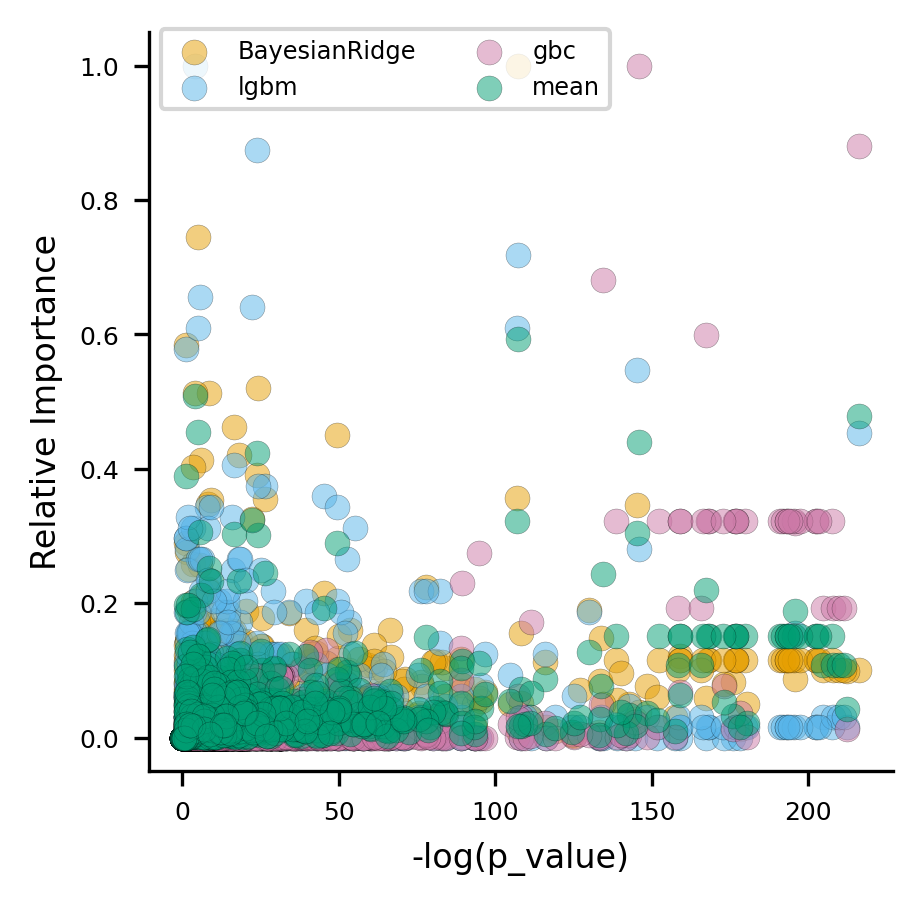

In [ ]:
scatter_plot = plot_scatter(summary_result=sr, report_dir=report_dir)

In [ ]:
%%time
mean_imp = mean_importance(top, report_dir=report_dir)

CPU times: total: 172 ms
Wall time: 163 ms


mean Done


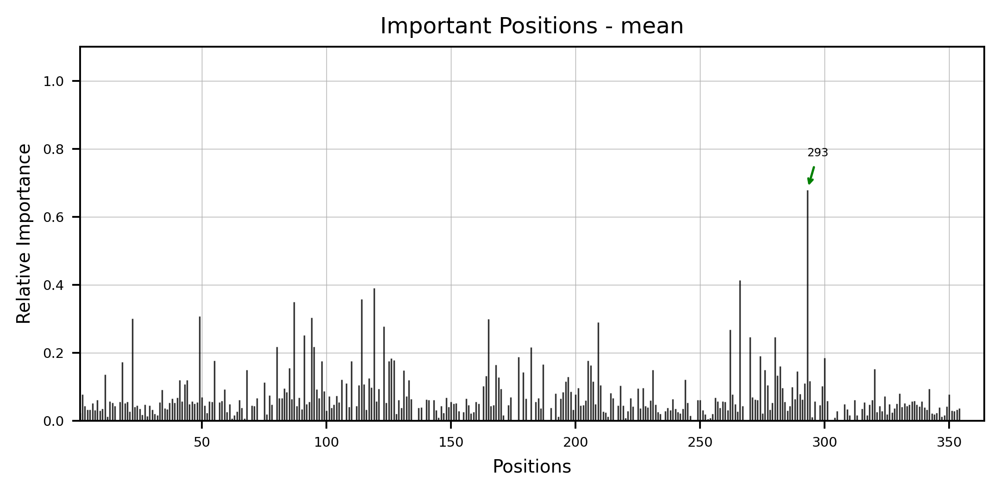

In [ ]:
dp_plot(importance=mean_imp,imp_col='mean', model_name='mean', report_dir=report_dir)

In [ ]:
tr = prep_pipeline[:4].fit_transform(tr)

BayesianRidge Done
BayesianRidge  Done
lgbm Done
lgbm  Done
gbc Done
gbc  Done


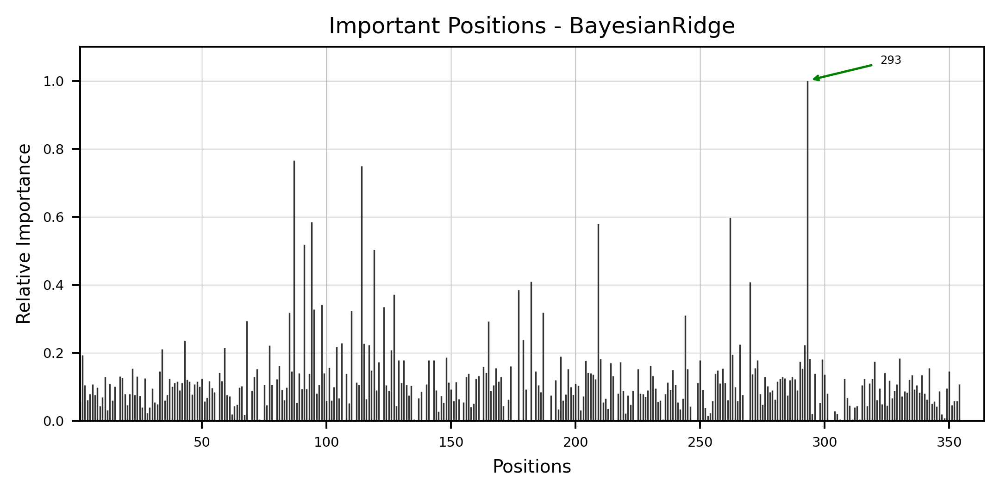

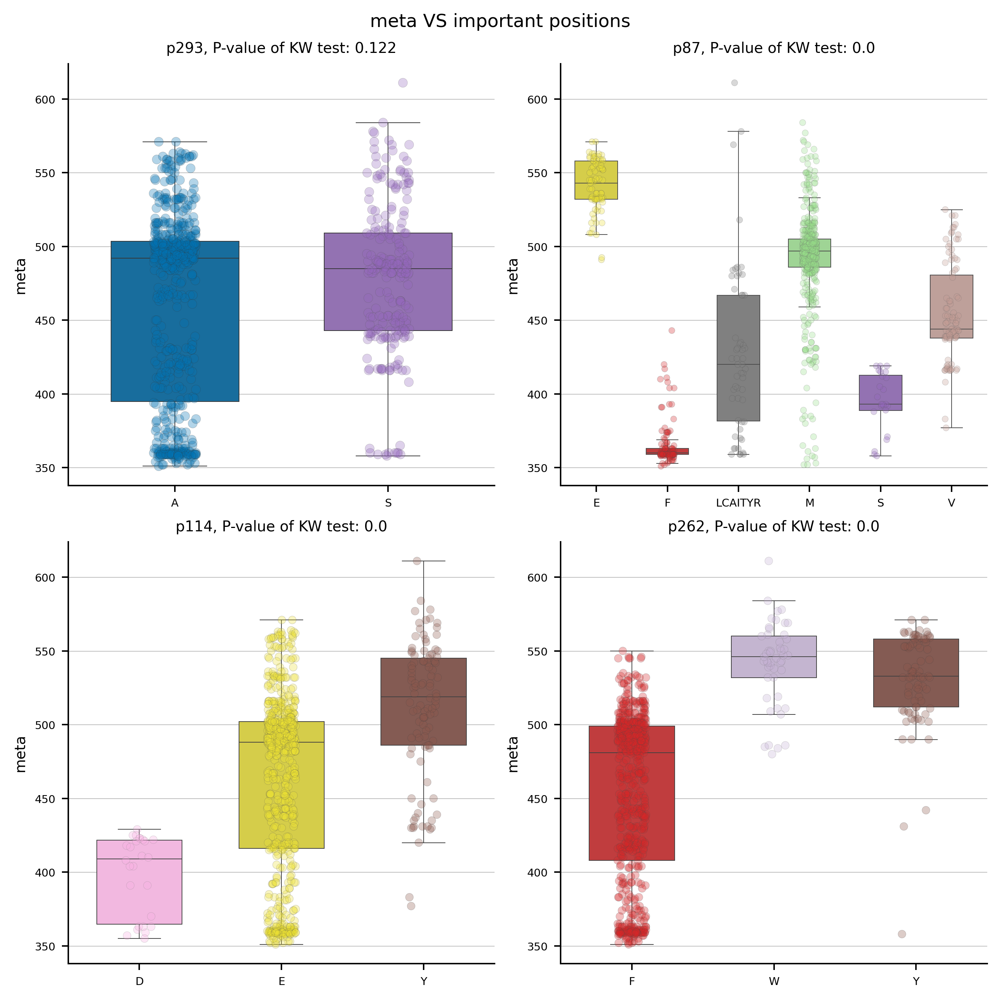

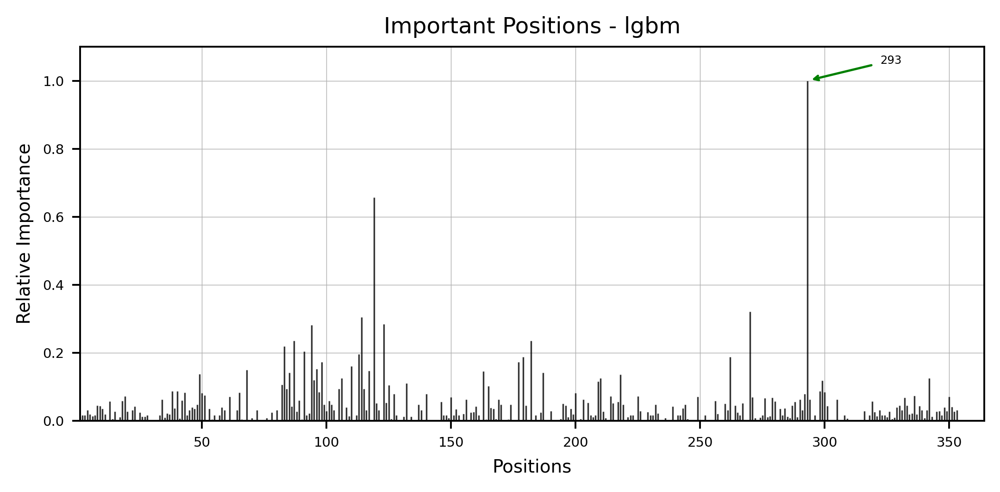

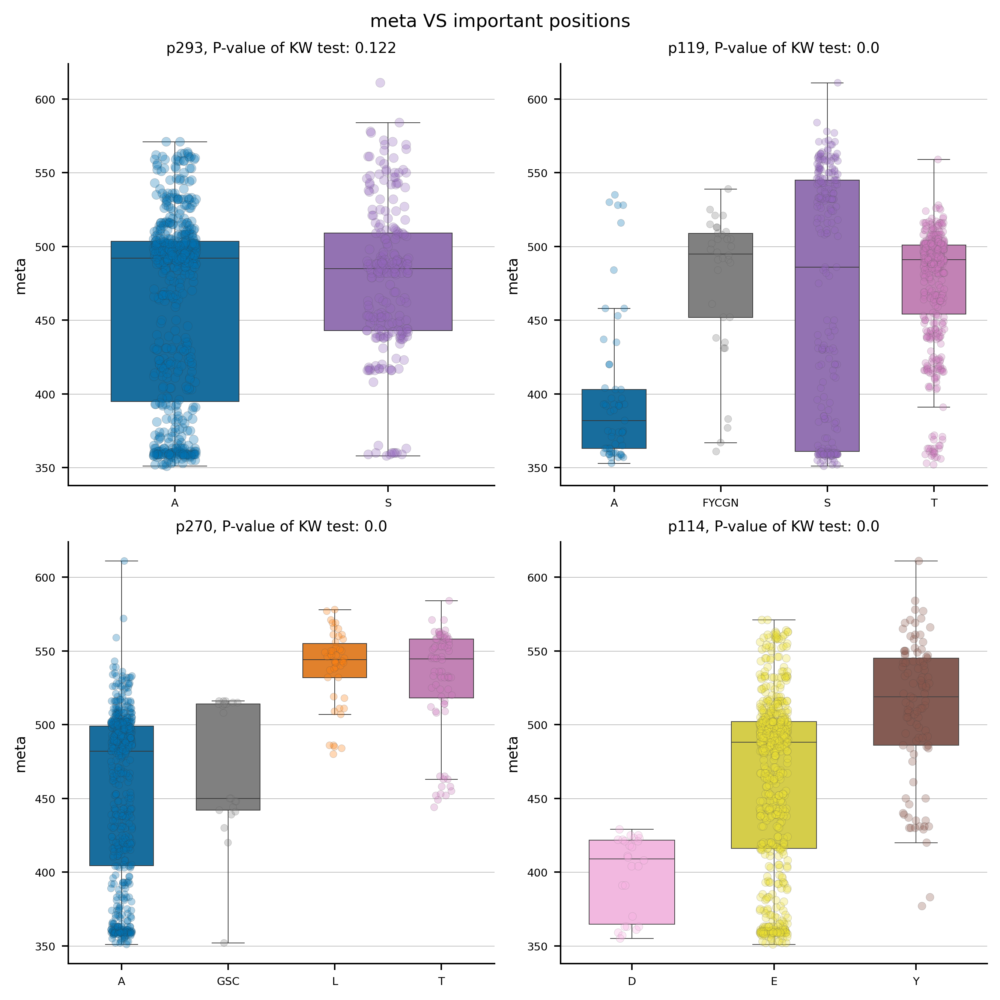

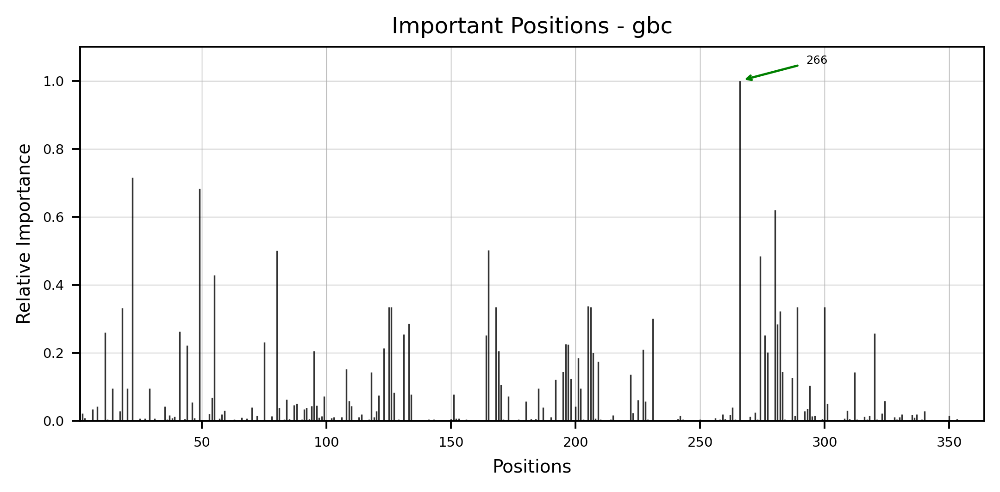

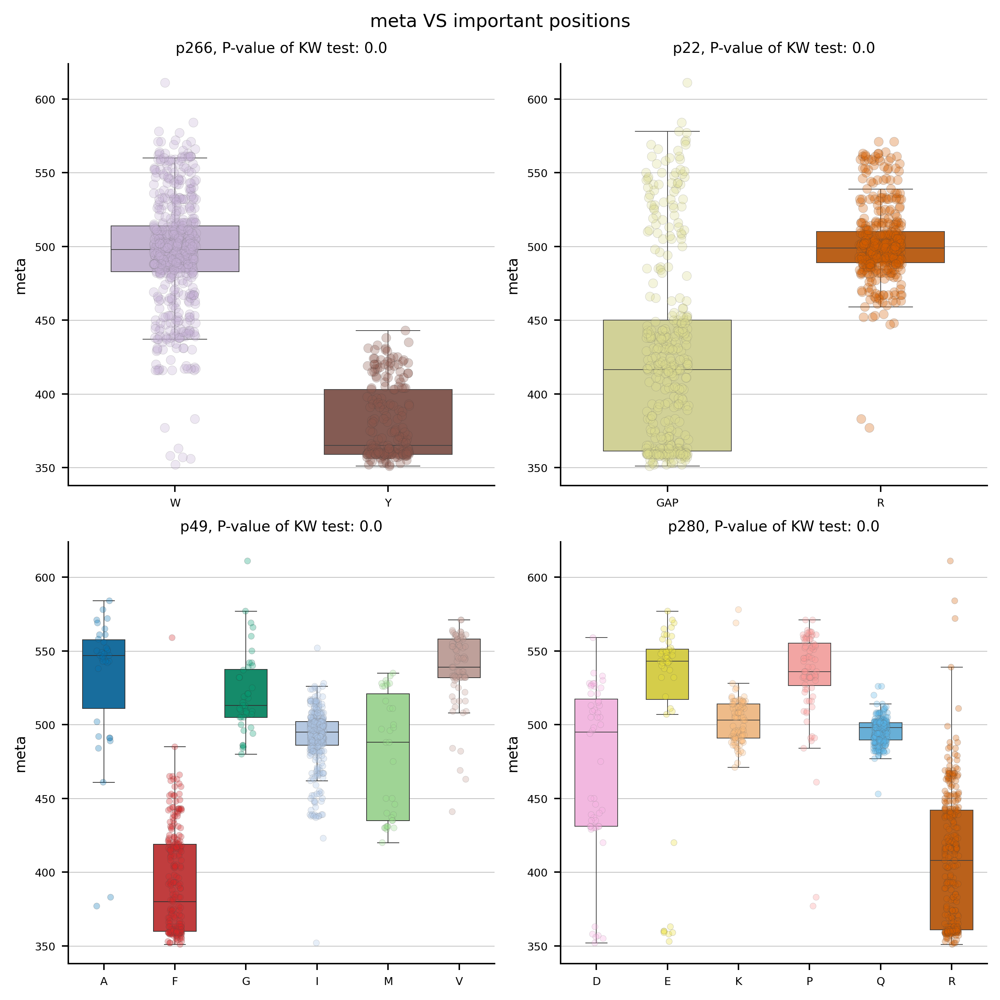

In [ ]:
for model in top:
    model_name = model.steps[-1][0]
    dp_plot(importance=importance_from_pipe(model),
            imp_col='standard_value',
            model_name = model_name, report_dir=report_dir)
    
    plot_imp_model(importance=importance_from_pipe(model), 
               X_train=tr, y_train=y, model_name=model_name,
                   meta_var='meta', model_type=ana_type, report_dir=report_dir)

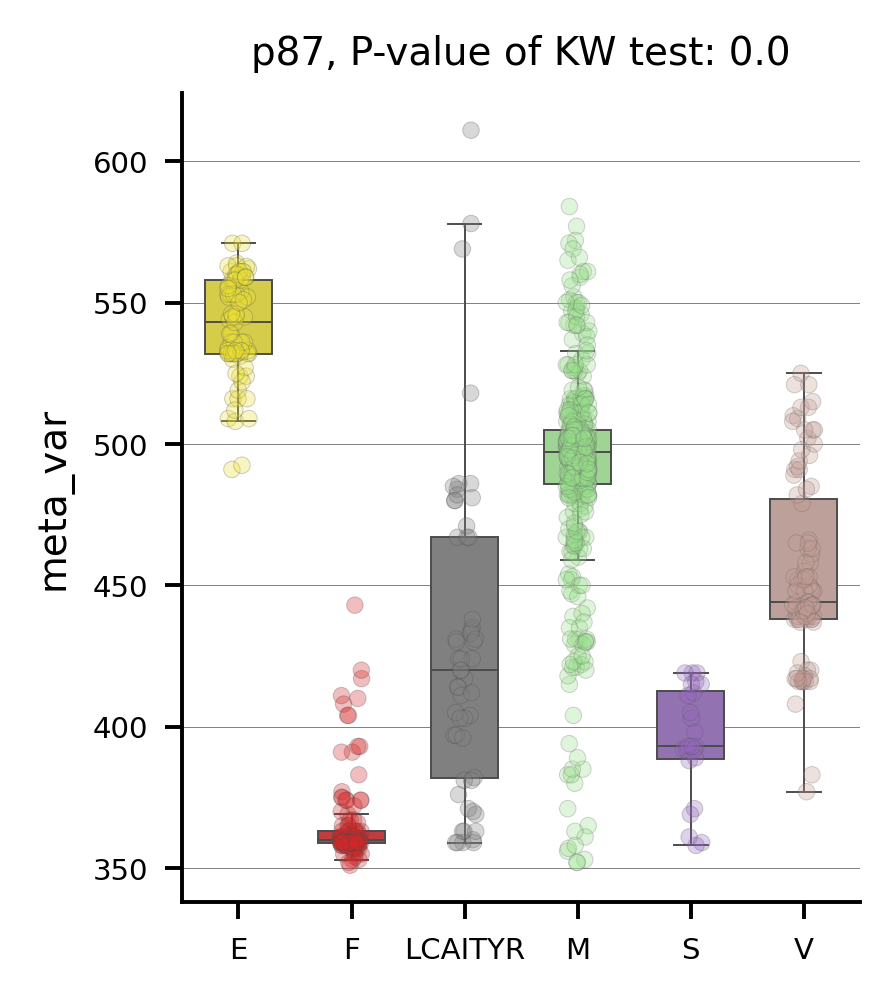

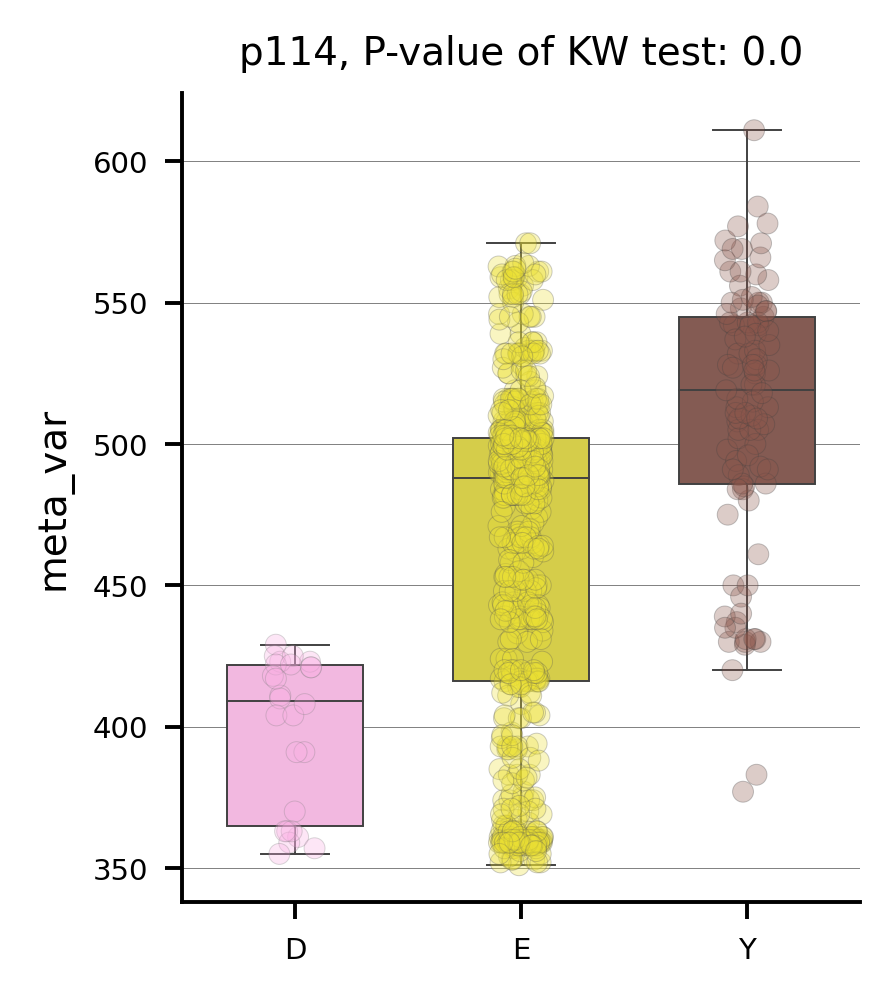

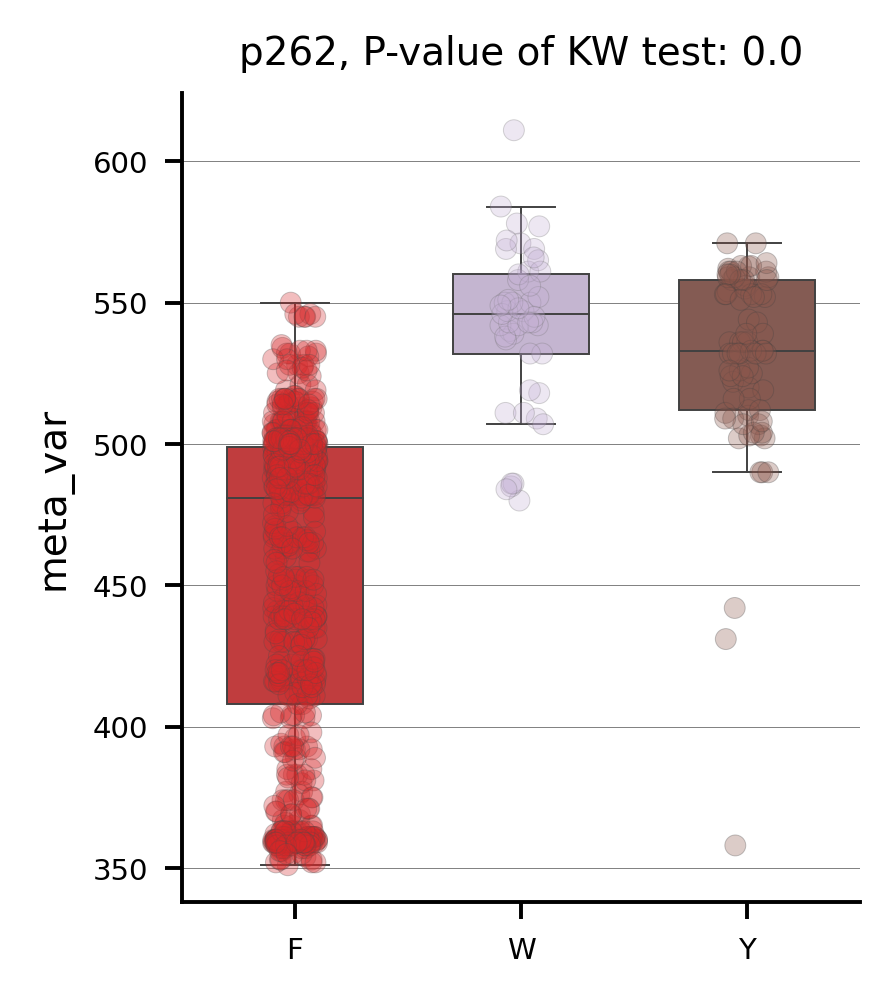

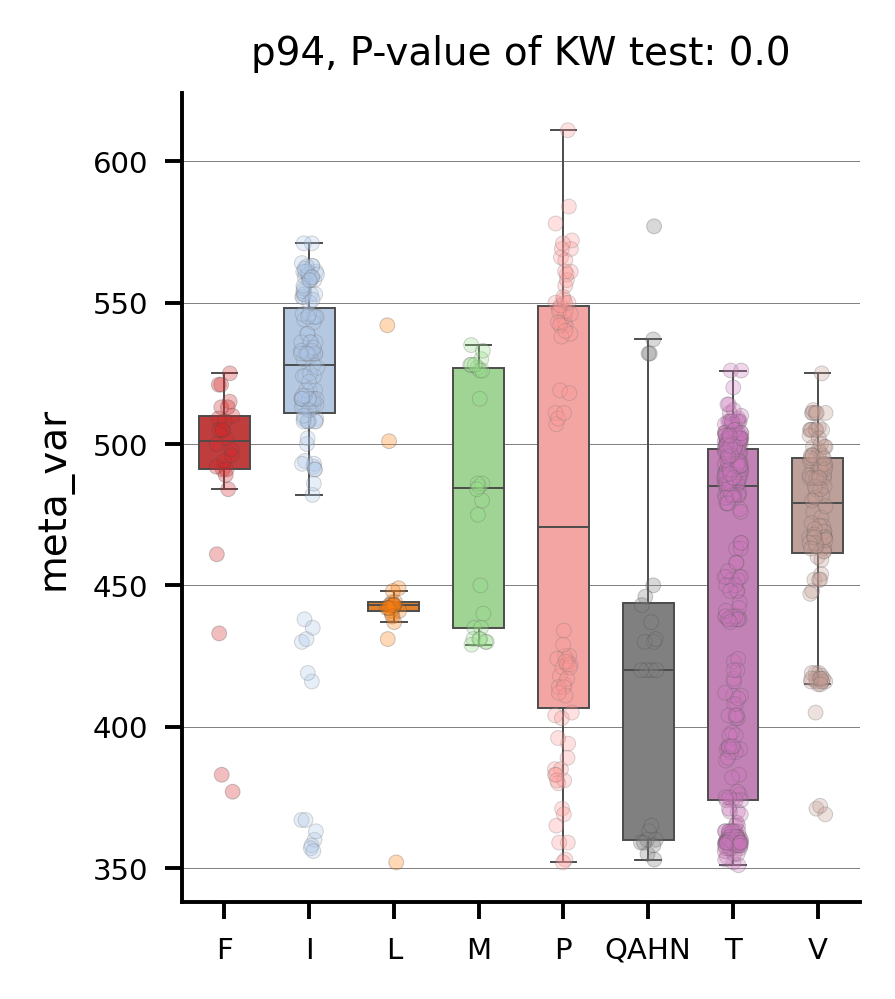

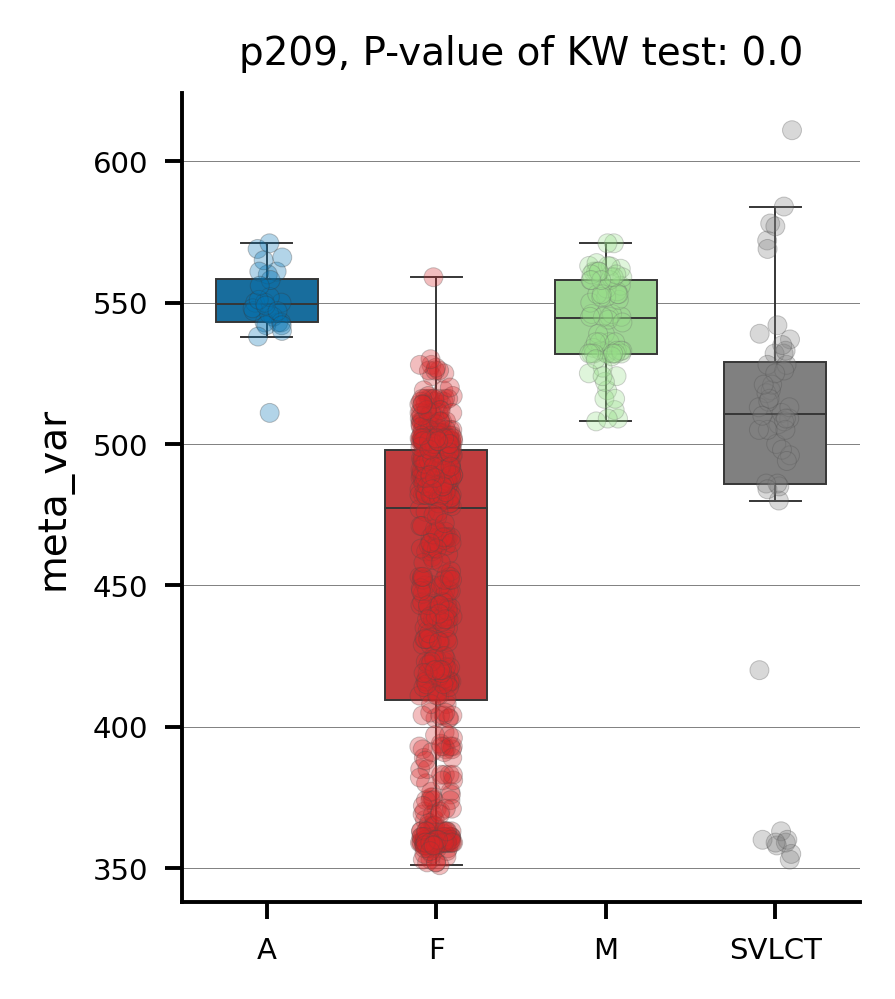

...

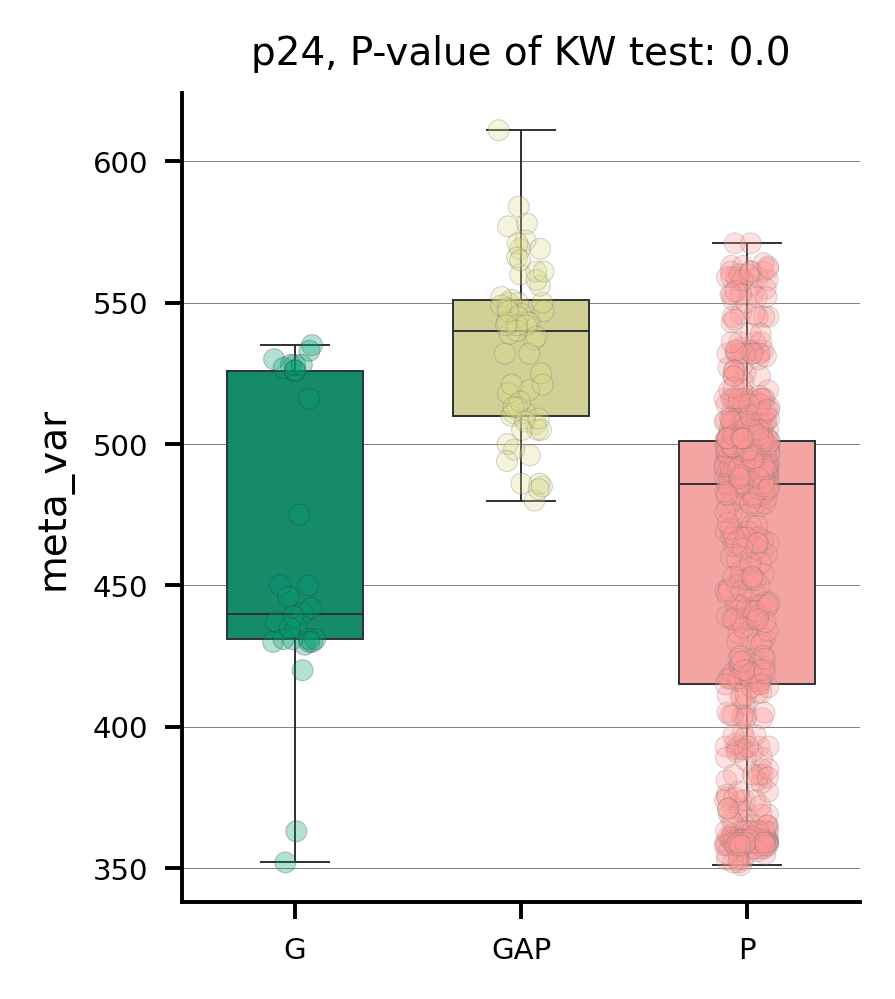

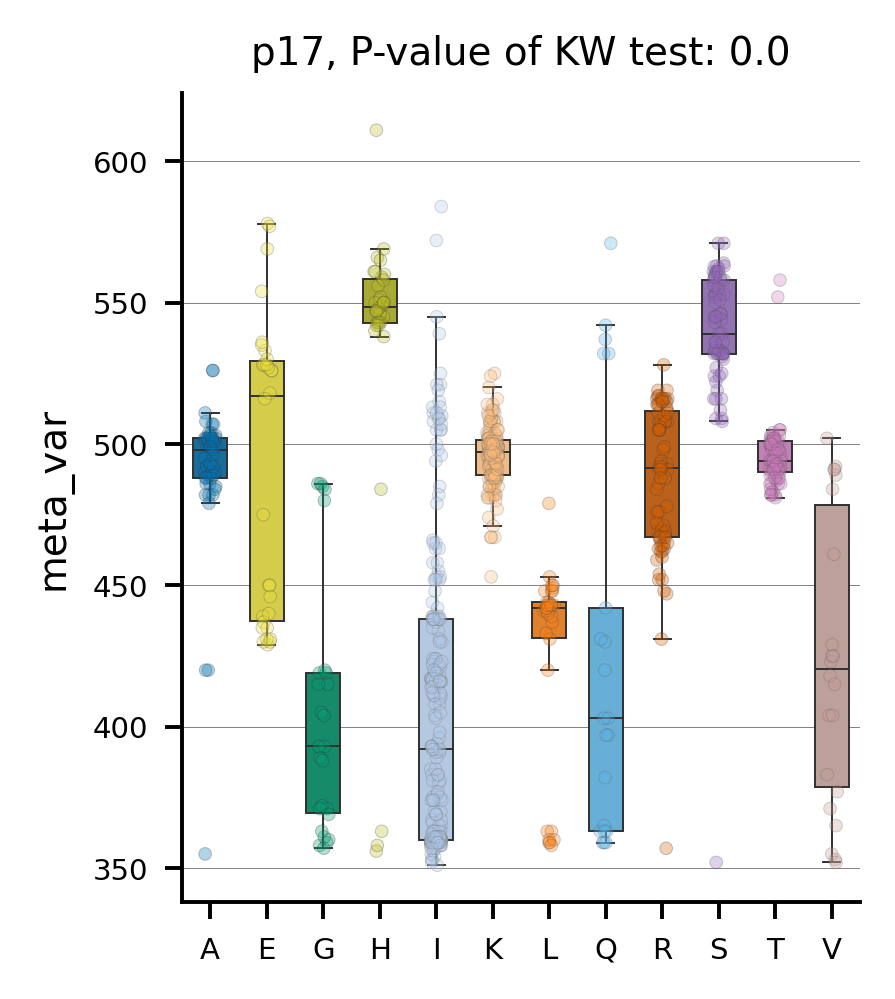

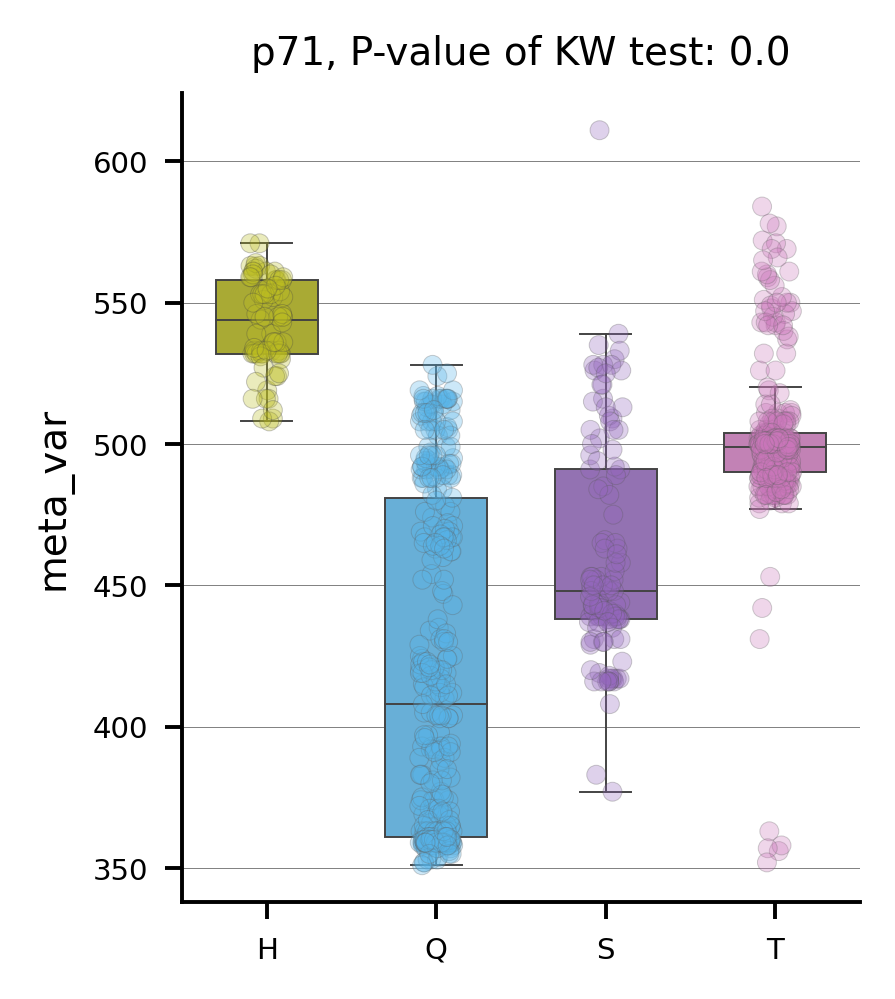

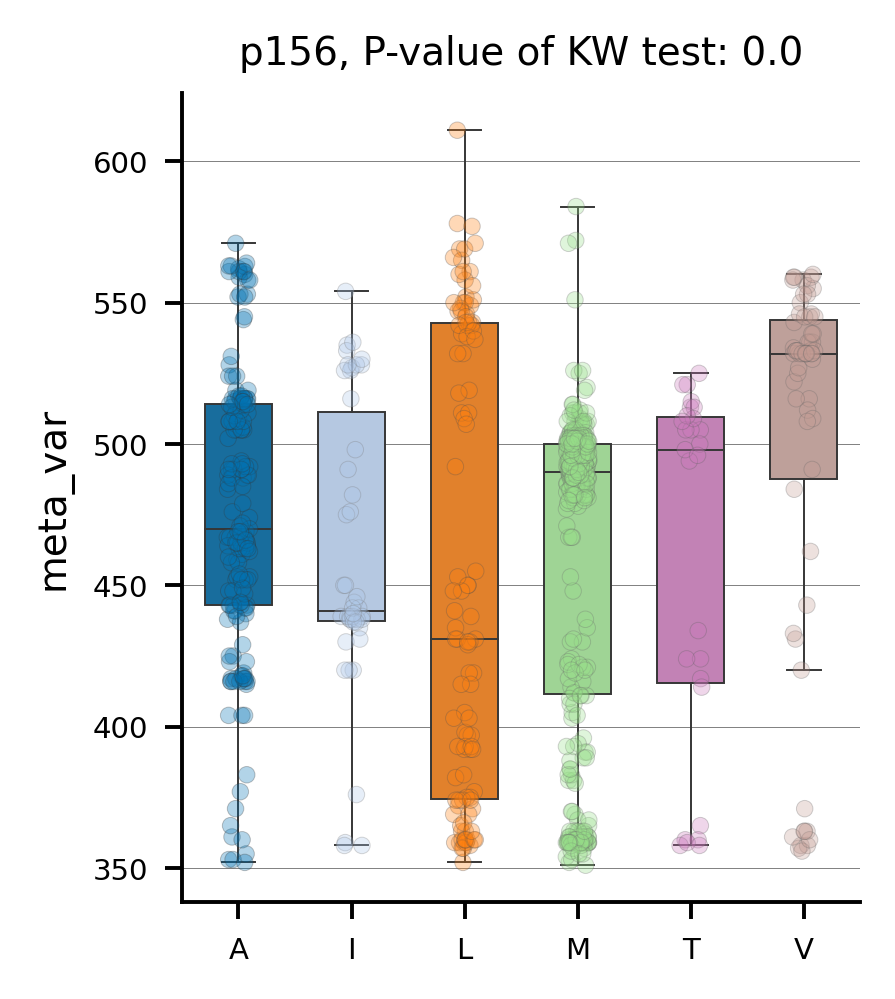

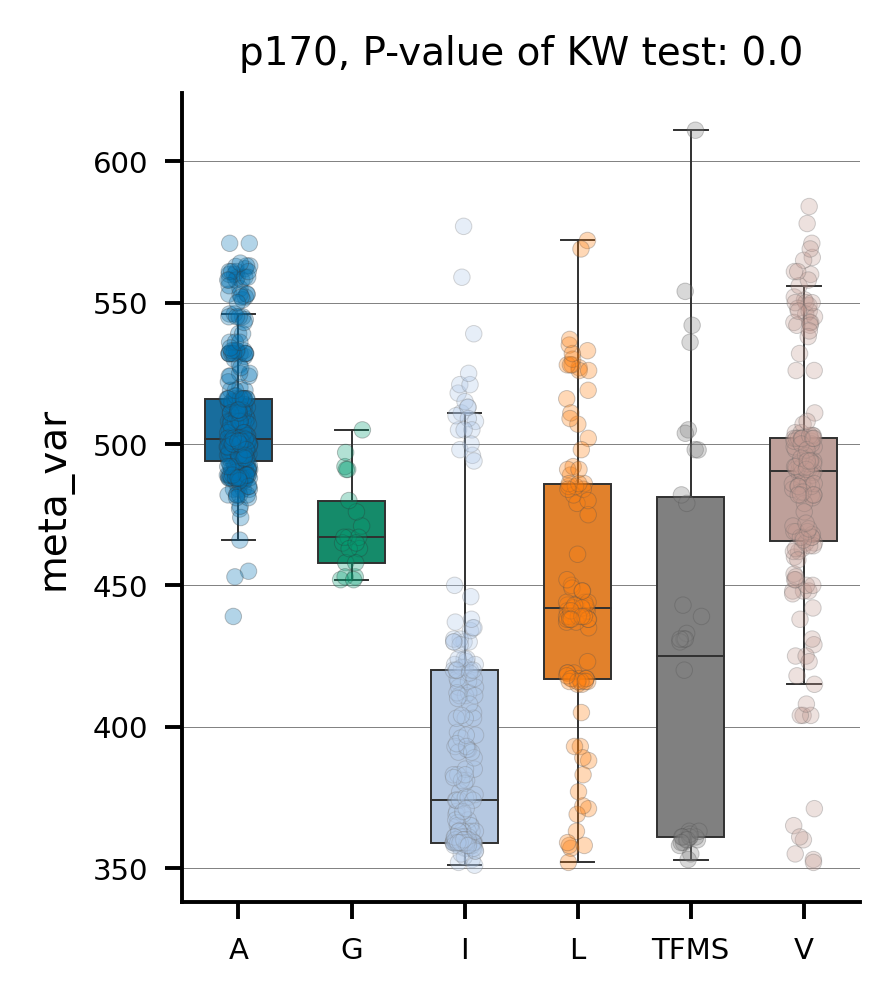

In [ ]:
pl = plot_imp_all(final_models=top,
                  X_train=tr, y_train=y,
                  model_type = ana_type,
                  report_dir=report_dir, max_plots=100,
                  figsize=(2.5, 3))

In [ ]:
from deepBreaks.utils import load_obj
import joblib
import pandas as pd
import matplotlib.pyplot as plt
import matplotlib.colors as mcolors
from sklearn.metrics import mean_absolute_error
from sklearn.metrics import mean_absolute_percentage_error
from sklearn.metrics import mean_squared_error
load_rf = load_obj(f'{report_dir}/lgbm.pkl')

In [ ]:
print(f'Here is a list of your top performing models to test...\n{top_model_list}')

Here is a list of your top performing models to test...
['wds_aligned_db_fmt_Lambda_Max_2023-07-29_18-38-50', 'wds_aligned_db_fmt_Lambda_Max_2023-07-29_18-38-50', 'wds_aligned_db_fmt_Lambda_Max_2023-07-29_18-38-50']


In [ ]:
predictions = load_rf.predict(unseen)
print(predictions)


[415.44011329 447.18613593 477.37026891 358.23214065 499.40294529
 533.13225019 499.82963342 363.10122167 494.21300267 546.90751594
 370.11423721 345.31609791 497.5715597  412.38978127 354.10979587
 482.6121017  498.62269056 464.54282885 484.40074805 516.41301717
 438.45514414 404.3296962  355.7688064  487.8543181  388.76219505
 496.02287326 487.92371076 438.18720461 385.95043301 501.89588959
 382.55139882 442.98699963 357.66442579 485.55340578 499.45898495
 416.57718898 426.34497352 355.7688064  553.87936177 556.99592531
 501.99994622 527.66526347 499.83079893 383.24265277 426.34497352
 498.24348711 555.49715423 508.70145236 393.80117487 553.52074029]


In [ ]:
base_test['Prediction'] = predictions
base_test['Difference'] = base_test['Prediction'] - base_test['Lambda_Max']
base_test = base_test[['Species', 'Opsin_Family', 'Accession','Lambda_Max','Prediction','Difference']]

base_test.to_csv(path_or_buf= f'{report_dir}/basetest_results.csv',index = 'Feature',mode="w")

base_test.head()

,Species,Opsin_Family,Accession,Lambda_Max,Prediction,Difference
S517,Lucania_goodei,SWS2,Q7T2U7,397.0,415.440113,18.440113
S540,Carassius_auratus,SWS2,L11864.1_G217S,442.0,447.186136,5.186136
S116,Rod_ancestor_pigmenta_E122Q_A292S,Rh1,pigmenta_E122Q_A292S,478.0,477.370269,-0.629731
S704,Mus_musculus,UVS,NP_031564.1_I146F,359.0,358.232141,-0.767859
S295,Ambystoma_tigrinum,Rh1,U36574,506.0,499.402945,-6.597055


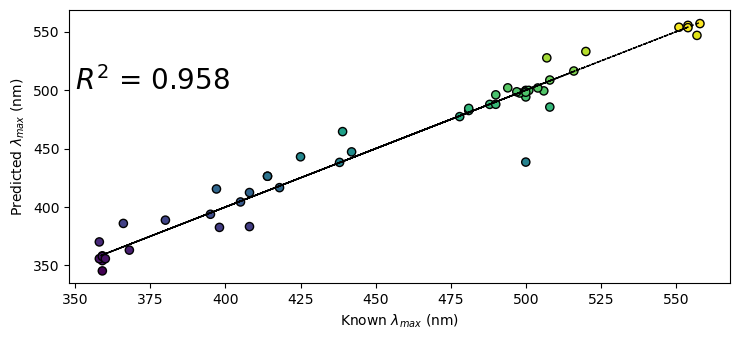

In [ ]:
plt.rcParams["figure.autolayout"] = True
plt.rcParams["figure.figsize"] = [7.50, 3.50]

plt.scatter(umd, predictions, c=predictions, ec = 'k', edgecolors='k', s = 35)
plt.plot(umd, umd, c = 'k', linewidth = '1.0', ls = '--', dashes = (1,3))
plt.xlabel('Known $λ_{max}$ (nm)')
plt.ylabel('Predicted $λ_{max}$ (nm)')
plt.annotate(f"$R^2$ = {load_rf.score(unseen, umd):.3f}",(350, 500), fontsize = 20, c = 'k')
plt.rcParams["figure.figsize"] = [7.50, 3.50]


#start, end = plt.get_xlim()
#plt.xaxis.set_ticks(np.arange(start, end, 25))
fileout = f'{report_dir}/50_hetero_dp.pdf'
plt.savefig(fileout)
plt.show()


In [ ]:
model_testing__report = f'{report_dir}/model_testing report.tsv'

base_rsq = load_rf.score(unseen, umd)
print(base_rsq)

base_mae = mean_absolute_error(predictions,umd)
print(base_mae)

base_mape = mean_absolute_percentage_error(predictions,umd)
print(base_mape)

base_sqe = mean_squared_error(predictions,umd)
print(base_sqe)

base_rsqe = mean_squared_error(predictions,umd, squared = False)
print(base_rsqe)

with open(model_testing__report , 'w') as f:
    f.write(f'Base Model R^2\tBase Model MAE\tBase Model MAPE\tBase Model SQE\tBase Model RSQE\n')
    f.write(f'{str(base_rsq)}\t{str(base_mae)}\t{str(base_mape)}\t{str(base_sqe)}\t{str(base_rsqe)}')




0.9575855782627765
7.794119953536065
0.01796006574629019
172.36162330041097
13.1286565687587


In [ ]:
msp_predictions = load_rf.predict(msp)
print(msp_predictions)

[492.20141294 413.0816932  549.44164864 452.51896477 423.55770571
 484.40074805 523.64910395 419.39738719 400.89336506 441.3338232
 505.00872492 390.67384868 457.80297241 436.54651139 556.73876859
 433.89564899 439.46173297 457.5536713  535.31612938 434.2988778
 535.24367905 428.17929428 417.86252265 538.55767191 549.14008233
 450.31223667 430.33490995 535.71243225 447.05394598 404.26920699
 545.83650859 435.13138889 424.42128087 439.45884342 420.90382017
 439.07656018]


In [ ]:
meta = "erg_msp_meta.tsv"
msp_meta = pd.read_csv(meta, sep="\t", index_col = False)
msp_meta.head()

,Species,Accession,Lambda_Max
0,Neogonodactylus_oerstedii,KJ127520.1,334
1,Neogonodactylus_oerstedii,KJ127521.1,383
2,Bombus_impatiens,XP_012237087.1,539
3,Bombus_impatiens,XP_003494923.1,424
4,Bombus_impatiens,AAV67326.1,347


In [ ]:
lmax_msp = (msp_meta['Lambda_Max'])
lm = []
for i in lmax_msp:
    lm.append(float(i))


In [ ]:
columns = ['Species','Accession','Lambda_Max','Predicted','Differnce']
msp_test = pd.DataFrame(index=msp.index, columns = columns)
msp_test['Predicted'] = msp_predictions
msp_test['Species'][0:31] = msp_meta['Species']
msp_test['Accession'][0:31] = msp_meta['Accession']

msp_test.head()

,Species,Accession,Lambda_Max,Predicted,Differnce
Neogonodactylus_oerstedii|334,Neogonodactylus_oerstedii,KJ127520.1,NaN,492.201413,NaN
Neogonodactylus_oerstedii|383,Neogonodactylus_oerstedii,KJ127521.1,NaN,413.081693,NaN
Bombus_impatiens|539,Bombus_impatiens,XP_012237087.1,NaN,549.441649,NaN
Bombus_impatiens|424,Bombus_impatiens,XP_003494923.1,NaN,452.518965,NaN
Bombus_impatiens|347,Bombus_impatiens,AAV67326.1,NaN,423.557706,NaN


In [ ]:

msp_test['Lambda_Max'][0:31] = lm
msp_test['Differnce'] = msp_test['Predicted'] - msp_test['Lambda_Max']
msp_test.head()


,Species,Accession,Lambda_Max,Predicted,Differnce
Neogonodactylus_oerstedii|334,Neogonodactylus_oerstedii,KJ127520.1,334.0,492.201413,158.201413
Neogonodactylus_oerstedii|383,Neogonodactylus_oerstedii,KJ127521.1,383.0,413.081693,30.081693
Bombus_impatiens|539,Bombus_impatiens,XP_012237087.1,539.0,549.441649,10.441649
Bombus_impatiens|424,Bombus_impatiens,XP_003494923.1,424.0,452.518965,28.518965
Bombus_impatiens|347,Bombus_impatiens,AAV67326.1,347.0,423.557706,76.557706


In [ ]:
msp_test.to_csv(path_or_buf= f'{report_dir}/msp_test_results.csv',index = 'Feature',mode="w")

In [ ]:
mae = mean_absolute_error(msp_test['Predicted'][0:31], msp_test['Lambda_Max'][0:31])
print(mae)
msp_rsq = load_rf.score(msp[0:31], msp_test['Lambda_Max'][0:31])
print(msp_rsq)


65.57256749508308


ValueError: Found input variables with inconsistent numbers of samples: [31, 30]

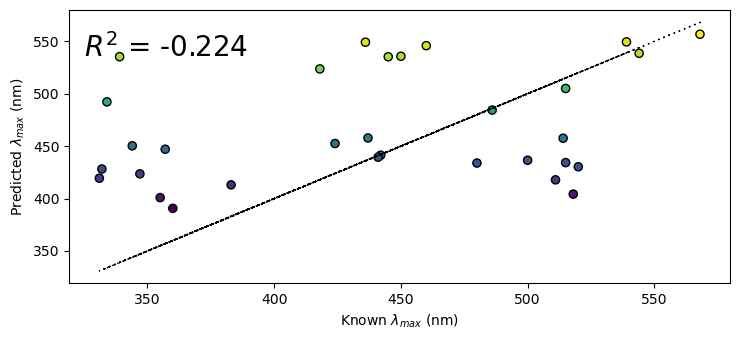

In [ ]:
plt.rcParams["figure.autolayout"] = True
plt.rcParams["figure.figsize"] = [7.50, 3.50]

plt.scatter(msp_test['Lambda_Max'][0:31], msp_predictions[0:31], c=msp_predictions[0:31], ec = 'k', edgecolors='k', s = 35)
plt.plot(msp_test['Lambda_Max'][0:31], msp_test['Lambda_Max'][0:31], c = 'k', linewidth = '1.0', ls = '--', dashes = (1,3))
plt.xlabel('Known $λ_{max}$ (nm)')
plt.ylabel('Predicted $λ_{max}$ (nm)')
plt.annotate(f"$R^2$ = {load_rf.score(msp[0:31], msp_test['Lambda_Max'][0:31]):.3f}",(325, 535), fontsize = 20, c = 'k')
plt.rcParams["figure.figsize"] = [7.50, 3.50]


#start, end = plt.get_xlim()
#plt.xaxis.set_ticks(np.arange(start, end, 25))
fileout = f'{report_dir}/31_msp_dp.pdf'
plt.savefig(fileout)
plt.show()

Below is just a way for me to properly format test data for previously trained models using the base training data... 

# importing deepBreaks libraries 
from deepBreaks.utils import get_models, get_scores, get_params, make_pipeline
from deepBreaks.preprocessing import MisCare, ConstantCare, URareCare, CustomOneHotEncoder
from deepBreaks.preprocessing import FeatureSelection, CollinearCare
from deepBreaks.preprocessing import read_data
from deepBreaks.models import model_compare_cv, finalize_top, importance_from_pipe, mean_importance, summarize_results
from deepBreaks.visualization import plot_scatter, dp_plot, plot_imp_model, plot_imp_all
import warnings
import datetime
import os
import numpy as np
import csv
import pandas as pd

# defining user params, file pathes, analysis type

# path to sequences
seqFileName = 'wds_fmt_msp.fasta' 

# path to metadata
metaDataFileName = 'wds_meta.tsv' 

# name of the phenotype
mt = 'Lambda_Max'

# type of the sequences
seq_type = 'aa'

# type of the analysis if it is a classification model, then we put cl instead of reg
ana_type = 'reg' 

# making a unique directory for saving the reports of the analysis
print('direcory preparation')
dt_label = datetime.datetime.now().strftime('%Y-%m-%d_%H-%M-%S')
seqFile = seqFileName.split('.')[0]
report_dir = str(seqFile +'_' + mt + '_' + dt_label)
os.makedirs(report_dir)

print('reading meta-data')
# importing metadata
meta_data = read_data(metaDataFileName, seq_type = None, is_main=False)

# importing sequences data
print('reading fasta file')
tr = read_data(seqFileName, seq_type = seq_type, is_main=True, gap_threshold=0.6)

#start here with removing the bottom ~25 sequences 
msp = tr.iloc[856:].copy()
msp.head()

tr = tr.merge(meta_data.loc[:, mt],  left_index=True, right_index=True)
tr.shape

sample_n = 50
n = 0
while n < 1:
    drop_indices = np.random.choice(tr.index, sample_n, replace=False)
    #print(drop_indices)
    #drop_indices = np.append(drop_indices,['Bovine'])
    #print(drop_indices)
    if 'Bovine' in drop_indices:
        pass
    else:
        n+=1

unseen = tr.loc[drop_indices].copy()
umd = unseen.loc[:, mt].values

unseen.drop(mt, axis=1, inplace=True)
tr = tr.drop(drop_indices)

y = tr.loc[:, mt].values
tr.drop(mt, axis=1, inplace=True)
print('Shape of data is: ', tr.shape)


# <font color=red>STEP 4: Translate Candidate STSs</font> 
## Optional step IF running the classifier model, but could still be useful.
### To find CSTSs, got to the deepBreaks output folder and find the excel sheet 'avg_top_models_feature_importance'
### Sort the top model's feature importance column by 'largest-to-smallest' and take x# of those positions.

In [ ]:
import pandas as pd
import os

In [ ]:
#STEP 4: Translate Candidate STSs 
#Optional step IF running the classifier model, but could still be useful.
#To find CSTSs, got to the deepBreaks output folder and find the excel sheet 'avg_top_models_feature_importance'
#Sort the top model's feature importance column by 'largest-to-smallest' and take x# of those positions.
m = 0
tm = ''
k=0
gaps=0
#import importance_report.csv from report_dir
true_pos = []
aa = []
tmd = []

df = pd.read_csv(f'{report_dir}\importance_report.csv')

#take the list of important sites and translate them to the bovine standard equivalent, we do this by taking the site number and subtracting the number of '-' between the start of the sequence and the desired site. 
for rows in bovine.values:  
    rows = str(rows)
    print(rows)
    if rows == 'nan':
    #We want to write the 'true_pos', 'aa', and 'TMD' to the 'importance_report' csv file
        gaps += 1
        k += 1
        true_pos.append('NA')
        aa.append('-')
        tmd.append('NA')
    else:
        #print("The number of gaps is " + str(gaps))
        k+=1
        trans_site = k - gaps

        if trans_site in range(39,66):
            tm = '1'
        elif trans_site in range(3,38):
            tm = 'N-Termina'
        elif trans_site in range(72,100):
            tm = '2'
        elif trans_site in range(110,141):
            tm = '3'
        elif trans_site in range(151,174):
            tm = '4'
        elif trans_site in range(200,231):
            tm = '5'
        elif trans_site in range(245,276):
            tm = '6'
        elif trans_site in range(285,311):
            tm = '7'
        else:
            tm = 'NA'
        
        true_pos.append(str(trans_site))
        aa.append(rows)
        tmd.append(tm)
true_pos.pop()
aa.pop()
tmd.pop()

df['true_position'] = true_pos
df['TMD'] = tmd
df['amino_acid'] = aa

df.to_csv(path_or_buf= os.path.join(report_dir,r'importance_report.csv'),index = 'Feature',mode="w")
df.head()


M
N
G
T
E
G
P
N
F
Y
V
P
F
nan
S
N
K
T
G
V
V
R
S
P
F
E
A
P
Q
Y
Y
L
A
E
P
W
Q
F
S
M
L
A
A
Y
M
F
L
L
I
M
L
G
F
P
I
N
F
L
T
L
Y
V
T
V
Q
H
K
K
L
R
T
P
L
N
Y
I
L
L
N
L
A
V
A
D
L
F
M
V
F
G
G
F
T
T
T
L
Y
T
S
L
H
G
Y
F
V
F
G
P
T
G
C
N
L
E
G
F
F
A
T
L
G
G
E
I
A
L
W
S
L
V
V
L
A
I
E
R
Y
V
V
V
C
K
P
M
S
N
F
R
F
G
E
N
H
A
I
M
G
V
A
F
T
W
V
M
A
L
A
C
A
A
P
P
L
V
G
W
S
R
Y
I
P
E
G
M
Q
C
S
C
G
I
D
Y
Y
T
P
H
E
E
T
N
N
E
S
F
V
I
Y
M
F
V
V
H
F
I
I
P
L
I
V
I
F
F
C
Y
G
Q
L
V
F
T
V
K
E
A
A
A
Q
Q
Q
E
S
A
T
T
Q
K
A
E
K
E
V
T
R
M
V
I
I
M
V
I
A
F
L
I
C
W
L
P
Y
A
G
V
A
F
Y
I
F
T
H
Q
G
S
D
F
G
P
I
F
M
T
I
P
A
F
F
A
K
T
S
A
V
Y
N
P
V
I
Y
I
M
M
N
K
Q
F
R
N
C
M
V
T
T
L
C
C
G
K
P
L
G
nan
D
D
E
nan
A
S
T
T
V
S
K
T
E
nan
nan
nan
nan
nan
T
S
Q
V
A
P
A


,feature,BayesianRidge,lgbm,gbc,mean,true_position,TMD,amino_acid
0,1,0.055154,0.011719,0.002576,0.023149,1,NA,M
1,2,0.193108,0.015625,0.021381,0.076705,2,NA,N
2,3,0.104197,0.015625,0.006880,0.042234,3,N-Termina,G
3,4,0.060532,0.031250,0.002336,0.031373,4,N-Termina,T
4,5,0.078550,0.018229,0.000686,0.032488,5,N-Termina,E
